# Annotations using clustering for cells for tonsil_s1

In [1]:
slide_id = "tonsil_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_tonsil_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 33969, 47351), (3, 16985, 23676)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (864388, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (864388, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (864388, 377)
      └── 'table_nuclei': AnnData (864388, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 864388 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,2,0,0,0,0,2,127.521255,10.882657,cell_labels
1,aaaaaaab-1,45,0,0,0,0,45,964.853629,21.855626,cell_labels
2,aaaaaaac-1,29,0,0,0,0,29,563.459708,40.008439,cell_labels
3,aaaaaaad-1,9,0,0,0,0,9,229.438915,19.146251,cell_labels
4,aaaaaaae-1,11,0,0,0,0,11,147.028755,17.520626,cell_labels
...,...,...,...,...,...,...,...,...,...,...
864383,aaandahp-1,77,0,0,0,0,77,29.487032,16.617501,cell_labels
864384,aaandaia-1,53,0,0,0,0,53,22.713595,14.088751,cell_labels
864385,aaandaib-1,116,0,0,0,0,116,44.930470,26.642188,cell_labels
864386,aaandaic-1,111,0,0,0,0,111,49.310627,23.255470,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown
VCAN,ENSG00000038427,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 761694 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,19.732738,NK cell,14,0,0,4,4,T,T_CD8,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,37.727228,G2M DZ B,11,4,1,7,7,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,29.781184,Double negative T,19,4,5,9,9,Endothelial,Endothelial,normal_cell
aaaaaaaj-1,nucleus_boundaries,morpho,aaaaaaaj-1,56.967595,mregDC,54,4,5,9,9,Endothelial,Endothelial,normal_cell
aaaaaaam-1,nucleus_boundaries,morpho,aaaaaaam-1,132.800404,mregDC,75,4,5,9,9,Endothelial,Endothelial,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaandahp-1,nucleus_boundaries,morpho,aaandahp-1,15.193408,Pre-GC B,59,1,1,1,1,B,B,normal_cell
aaandaia-1,nucleus_boundaries,morpho,aaandaia-1,12.825143,LZ B,32,0,0,0,0,T,T,normal_cell
aaandaib-1,nucleus_boundaries,morpho,aaandaib-1,24.543885,Naive CD4 T,75,0,0,0,0,T,T,normal_cell
aaandaic-1,nucleus_boundaries,morpho,aaandaic-1,21.651146,Macrophage,79,0,0,7,7,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.012146,0.253818
ACE2,0.064486,0.580020
ACKR1,0.187951,1.011244
ACTA2,0.274974,1.212496
ACTG2,2.396843,2.812652
...,...,...
UnassignedCodeword_0499,0.000698,0.060930
VCAN,0.161714,0.935010
VSIG4,0.085333,0.672135
VWA5A,0.342649,1.319415


## 2. Preprocessing

<Axes: >

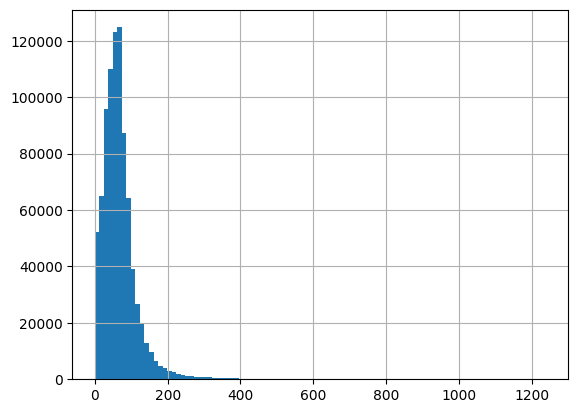

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

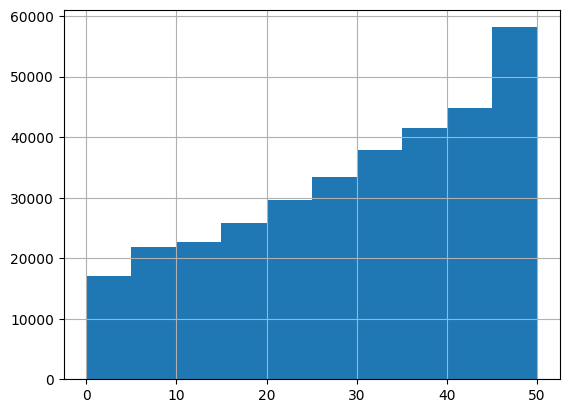

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 87481
Percentage of cells with less than 20 transcripts: 10.12%
-----
Number of cells with less than 15 transcripts: 61644
Percentage of cells with less than 15 transcripts: 7.13%
-----
Number of cells with less than 10 transcripts: 38919
Percentage of cells with less than 10 transcripts: 4.5%
-----
Number total of cells: 864388


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

821130


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


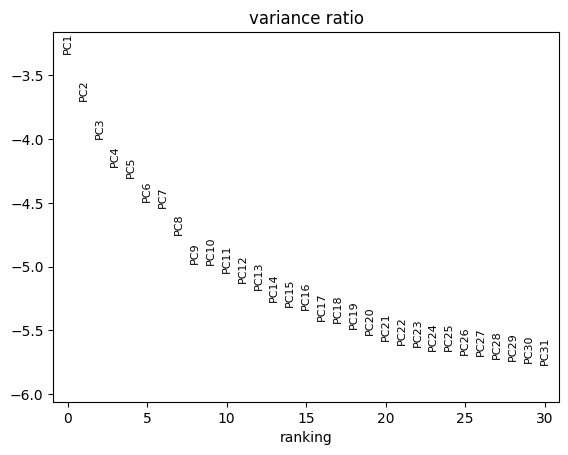

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 821130 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_3709/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


In [36]:
sc.tl.leiden(adata_cells, resolution=0.8, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.8', neighbors_key='pca_n10_pcs16')

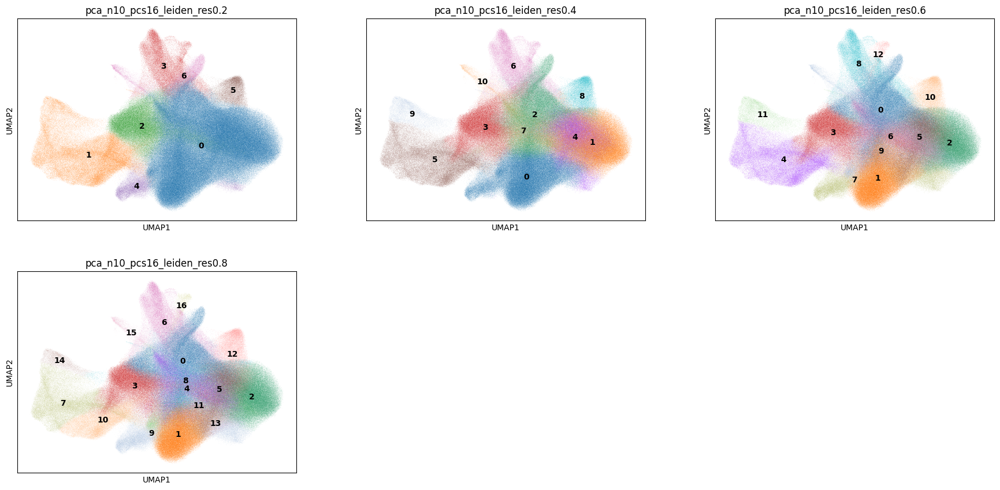

In [37]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.8'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['5', '0', '8', '9', '12', ..., '1', '7', '6', '10', '11']
Length: 13
Categories (13, object): ['0', '1', '2', '3', ..., '9', '10', '11', '12']

In [92]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.2'].isin(['6']), 'refine_res'] = '13'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '14'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '15'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'

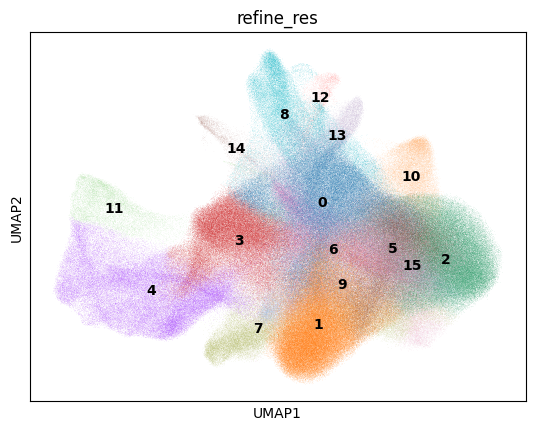

In [93]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [94]:
clustering_label = 'refine_res'

In [95]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

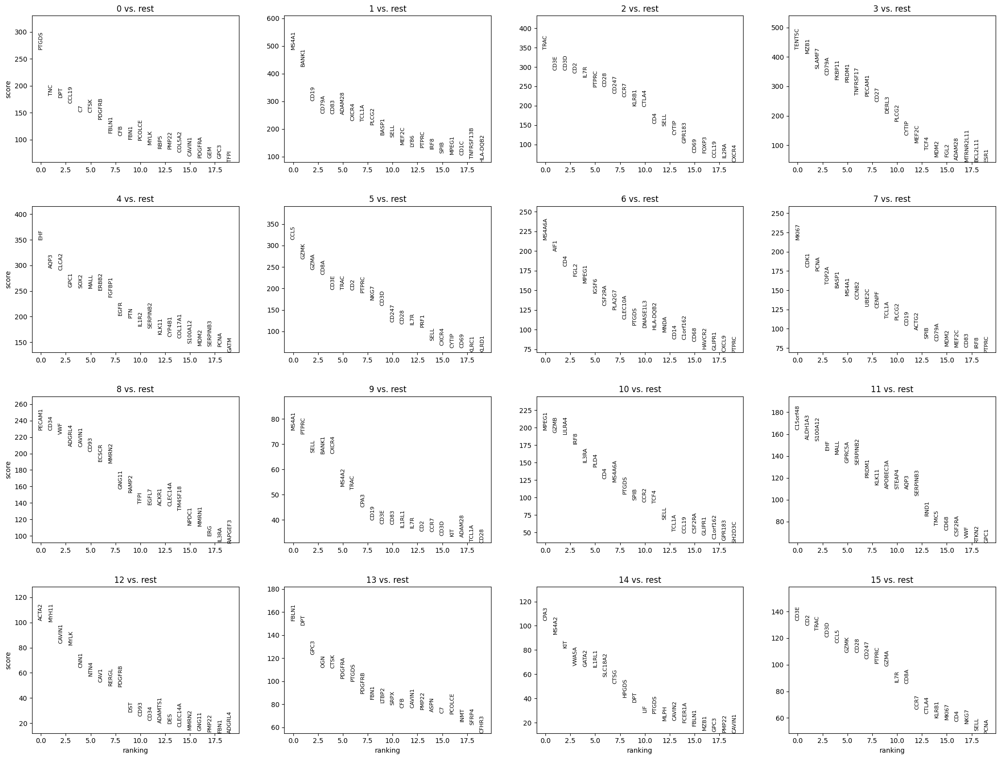

In [96]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [97]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [98]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [99]:
cluster_id = '0'

In [100]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage/DC,Macrophage/DC,normal_cell,29.9
1,NA,NA,NA,21.3
2,B,B,normal_cell,15.0
3,T,T,normal_cell,14.7
4,Plasma,Plasma,normal_cell,10.8


In [101]:
top_ranked_genes[cluster_id]

0     PTGDS
1       TNC
2       DPT
3     CCL19
4        C7
5      CTSK
6    PDGFRB
Name: 0, dtype: object

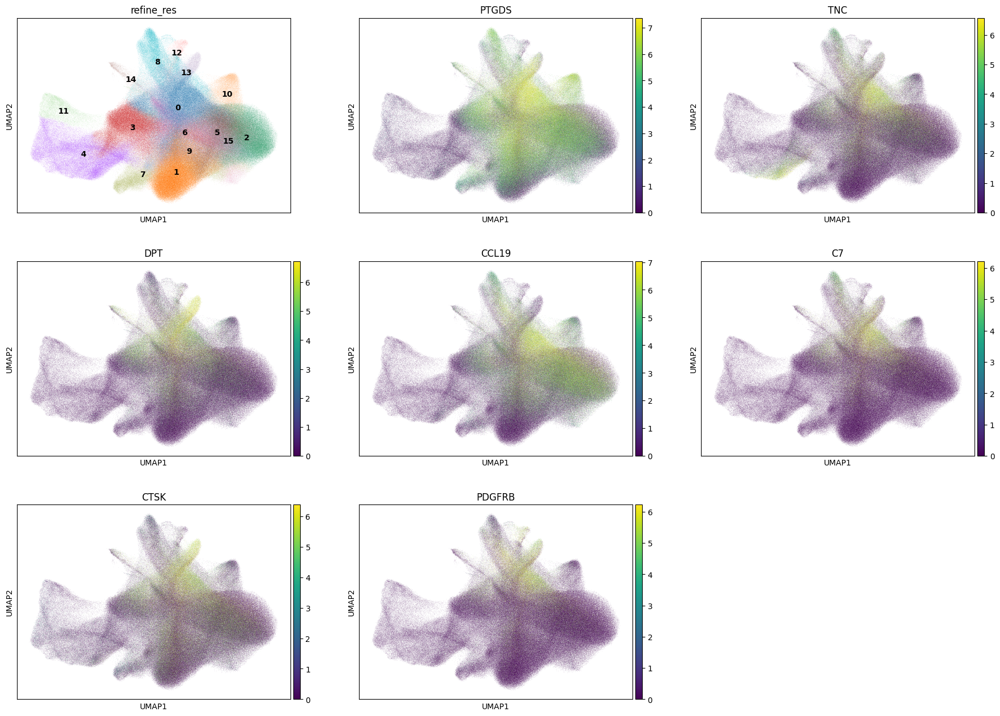

In [102]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [103]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 120849
Percentage of cells in cluster 0: 14.7


In [104]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.2. Cluster 1

In [105]:
cluster_id = '1'

In [106]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,85.5
1,T,T,normal_cell,7.4
2,NA,NA,NA,4.3
3,B,Proliferating_B,normal_cell,0.8
4,T,T_CD8,normal_cell,0.5


In [107]:
top_ranked_genes[cluster_id]

0     MS4A1
1     BANK1
2      CD19
3     CD79A
4      CD83
5    ADAM28
6     CXCR4
Name: 1, dtype: object

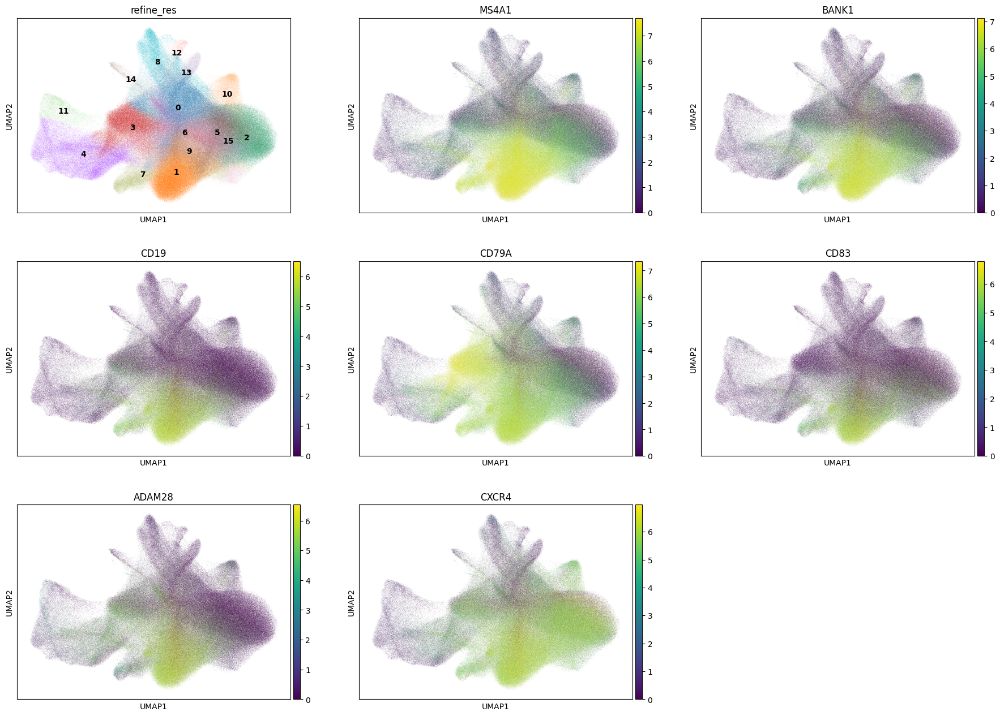

In [108]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [109]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 133530
Percentage of cells in cluster 1: 16.3


In [110]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.3. Cluster 2

In [111]:
cluster_id = '2'

In [112]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,91.4
1,NA,NA,NA,5.2
2,T,T_CD8,normal_cell,1.1
3,B,B,normal_cell,1.0
4,pDC,pDC,normal_cell,0.5


In [113]:
top_ranked_genes[cluster_id]

0     TRAC
1     CD3E
2     CD3D
3      CD2
4     IL7R
5    PTPRC
6     CD28
Name: 2, dtype: object

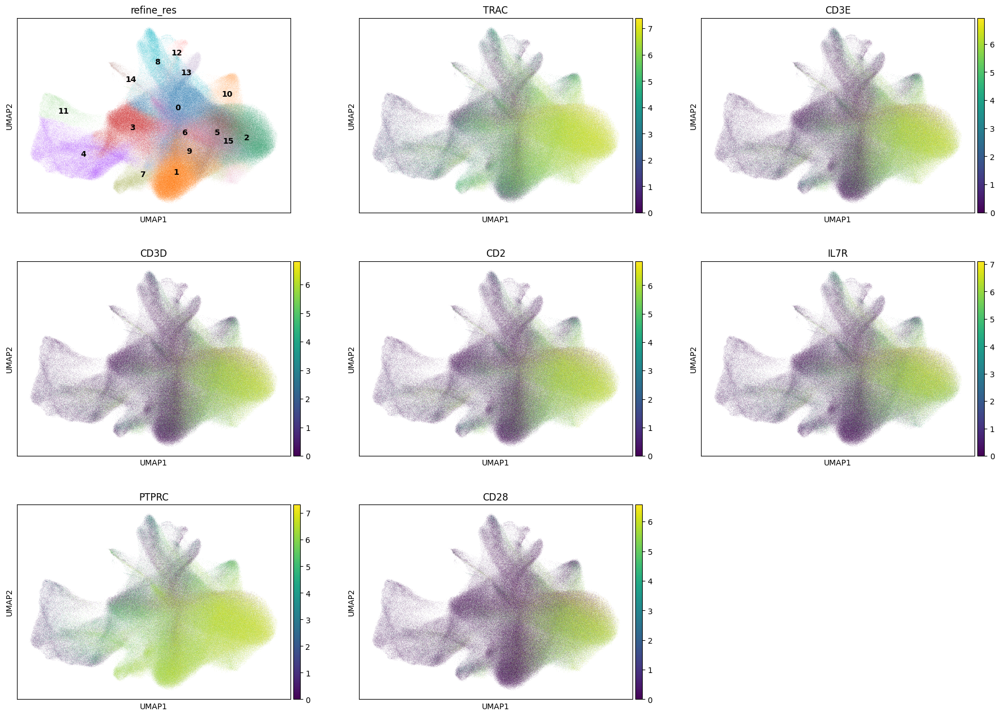

In [114]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [115]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 95335
Percentage of cells in cluster 2: 11.6


In [116]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.4. Cluster 3

In [117]:
cluster_id = '3'

In [118]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,74.6
1,B,B,normal_cell,8.3
2,T,T,normal_cell,7.6
3,NA,NA,NA,4.5
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,2.7


In [119]:
top_ranked_genes[cluster_id]

0      TENT5C
1        MZB1
2      SLAMF7
3       CD79A
4      FKBP11
5       PRDM1
6    TNFRSF17
Name: 3, dtype: object

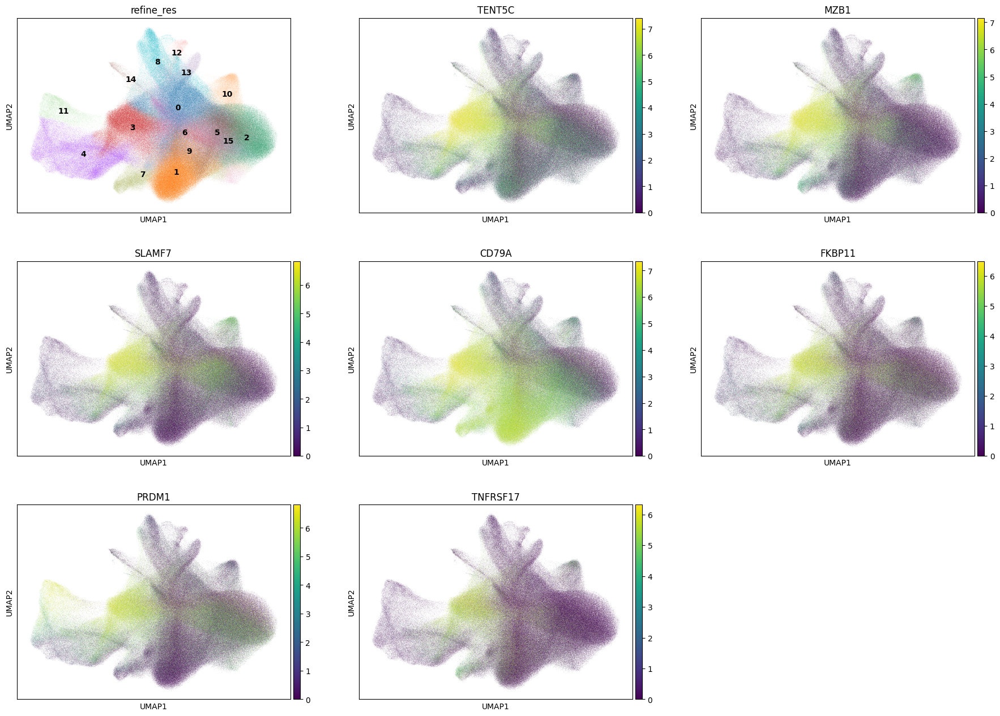

In [120]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [121]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 86599
Percentage of cells in cluster 3: 10.5


In [122]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.5. Cluster 4

In [123]:
cluster_id = '4'

In [124]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Epithelial,normal_cell,71.4
1,B,B,normal_cell,6.6
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,5.2
3,NA,NA,NA,4.7
4,Plasma,Plasma,normal_cell,4.5


In [125]:
top_ranked_genes[cluster_id]

0      EHF
1     AQP3
2    CLCA2
3     GPC1
4     SOX2
5     MALL
6    ERBB2
Name: 4, dtype: object

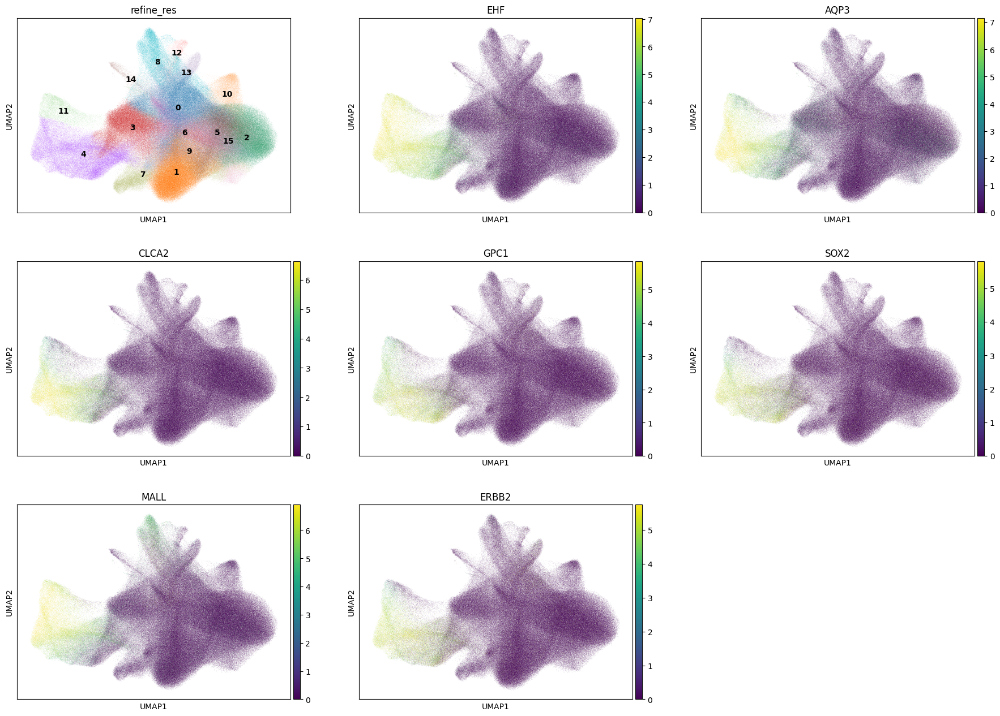

In [126]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [127]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 74475
Percentage of cells in cluster 4: 9.1


In [128]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.6. Cluster 5

In [129]:
cluster_id = '5'

In [130]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T_CD8,normal_cell,51.8
1,T,T,normal_cell,33.9
2,B,B,normal_cell,9.9
3,NA,NA,NA,2.2
4,Plasma,Plasma,normal_cell,0.7


In [131]:
top_ranked_genes[cluster_id]

0    CCL5
1    GZMK
2    GZMA
3    CD8A
4    CD3E
5    TRAC
6     CD2
Name: 5, dtype: object

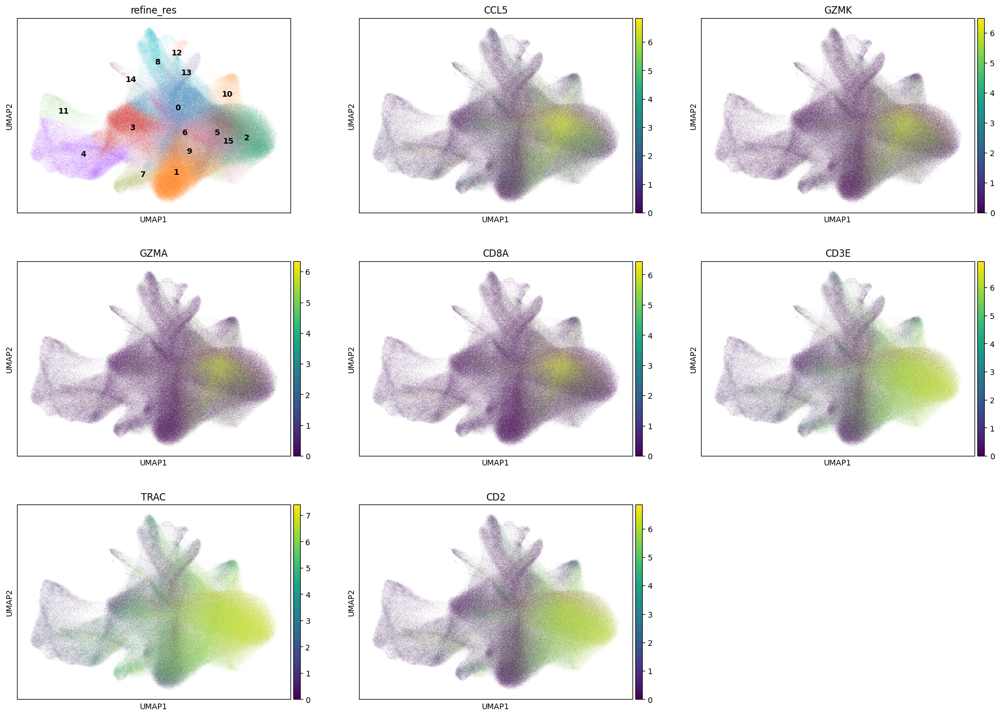

In [132]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [133]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 72900
Percentage of cells in cluster 5: 8.9


In [134]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.7. Cluster 6

In [135]:
cluster_id = '6'

In [136]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,44.9
1,T,T,normal_cell,35.4
2,B,B,normal_cell,12.0
3,T,T_CD8,normal_cell,2.3
4,NA,NA,NA,2.1


In [137]:
top_ranked_genes[cluster_id]

0    MS4A6A
1      AIF1
2       CD4
3      FGL2
4     MPEG1
5     IGSF6
6    CSF2RA
Name: 6, dtype: object

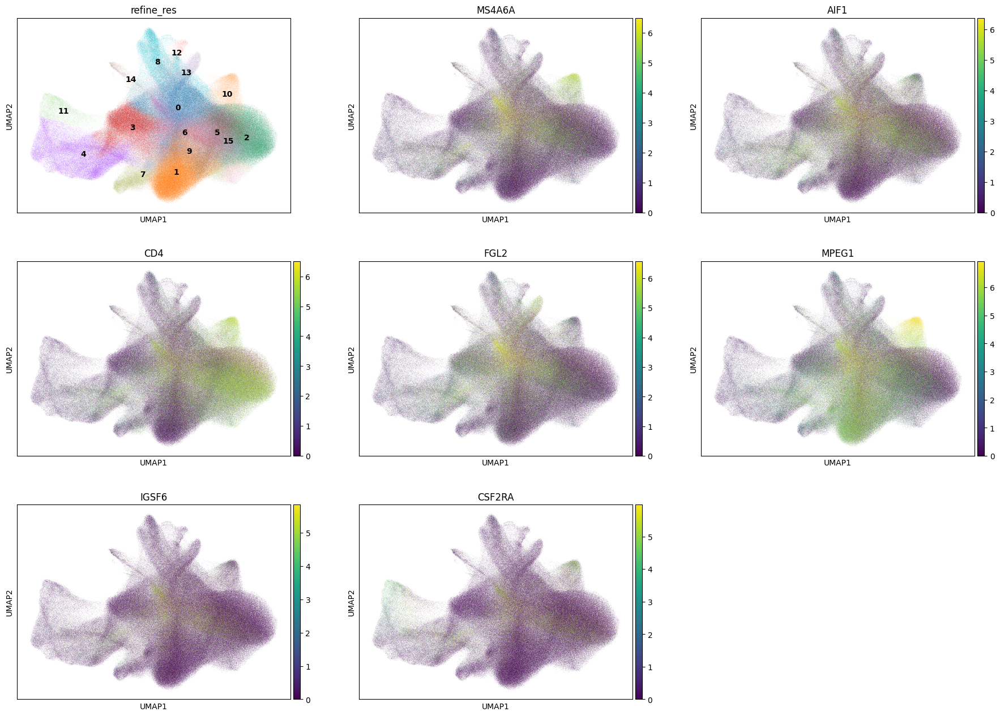

In [138]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [139]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 59731
Percentage of cells in cluster 6: 7.3


In [140]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.8. Cluster 7

In [141]:
cluster_id = '7'

In [142]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,Proliferating_B,normal_cell,50.3
1,T,T,normal_cell,25.6
2,B,B,normal_cell,17.1
3,NA,NA,NA,1.6
4,T,T_CD8,normal_cell,1.3


In [143]:
top_ranked_genes[cluster_id]

0    MKI67
1     CDK1
2     PCNA
3    TOP2A
4    BASP1
5    MS4A1
6    CCNB2
Name: 7, dtype: object

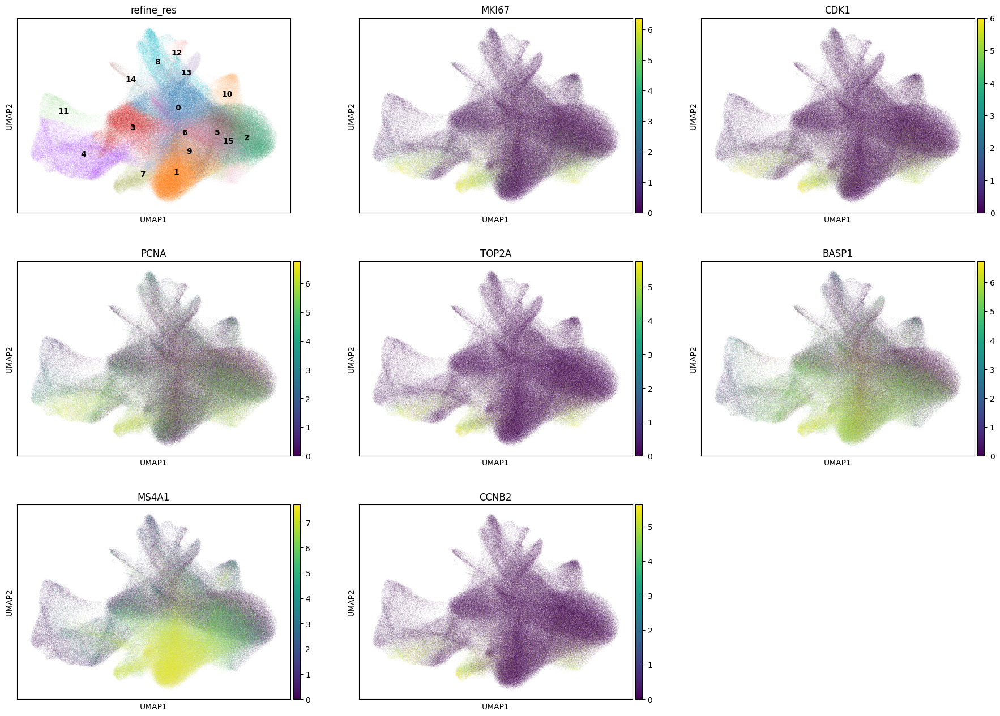

In [144]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [145]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 32301
Percentage of cells in cluster 7: 3.9


In [146]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_B'

### 5.9. Cluster 8

In [147]:
cluster_id = '8'

In [148]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,63.0
1,T,T,normal_cell,9.4
2,NA,NA,NA,9.1
3,Macrophage/DC,Macrophage/DC,normal_cell,6.0
4,Plasma,Plasma,normal_cell,4.2


In [149]:
top_ranked_genes[cluster_id]

0    PECAM1
1      CD34
2       VWF
3    ADGRL4
4    CAVIN1
5      CD93
6     ECSCR
Name: 8, dtype: object

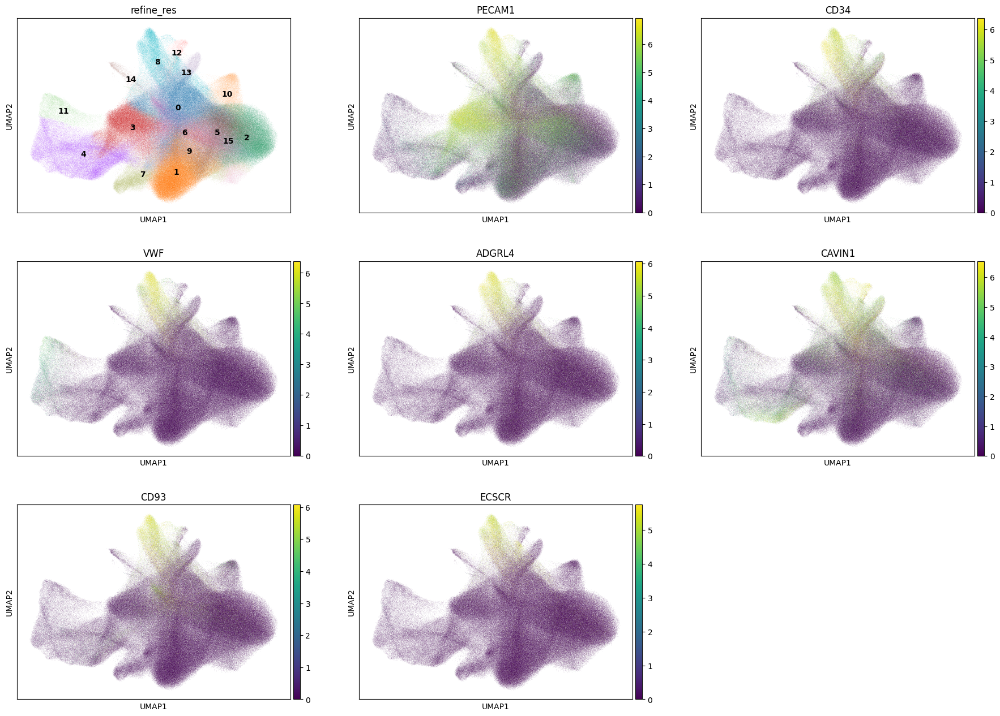

In [150]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [151]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 35794
Percentage of cells in cluster 8: 4.4


In [152]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.10. Cluster 9

In [153]:
cluster_id = '9'

In [154]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,52.8
1,T,T,normal_cell,37.3
2,T,T_CD8,normal_cell,4.0
3,NA,NA,NA,2.7
4,Plasma,Plasma,normal_cell,1.0


In [155]:
top_ranked_genes[cluster_id]

0    MS4A1
1    PTPRC
2     SELL
3    BANK1
4    CXCR4
5    MS4A2
6     TRAC
Name: 9, dtype: object

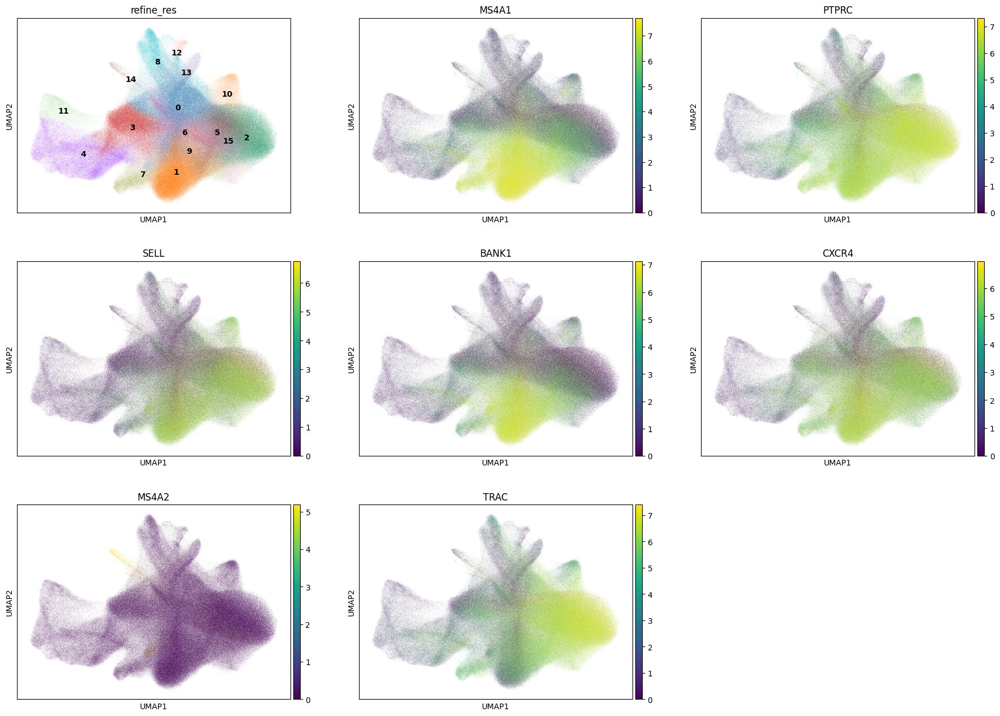

In [156]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [157]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 27199
Percentage of cells in cluster 9: 3.3


In [158]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.11. Cluster 10

In [159]:
cluster_id = '10'

In [160]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,pDC,pDC,normal_cell,60.9
1,T,T,normal_cell,16.6
2,B,B,normal_cell,8.8
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,3.8
4,NA,NA,NA,3.5


In [161]:
top_ranked_genes[cluster_id]

0     MPEG1
1      GZMB
2    LILRA4
3      IRF8
4     IL3RA
5      PLD4
6       CD4
Name: 10, dtype: object

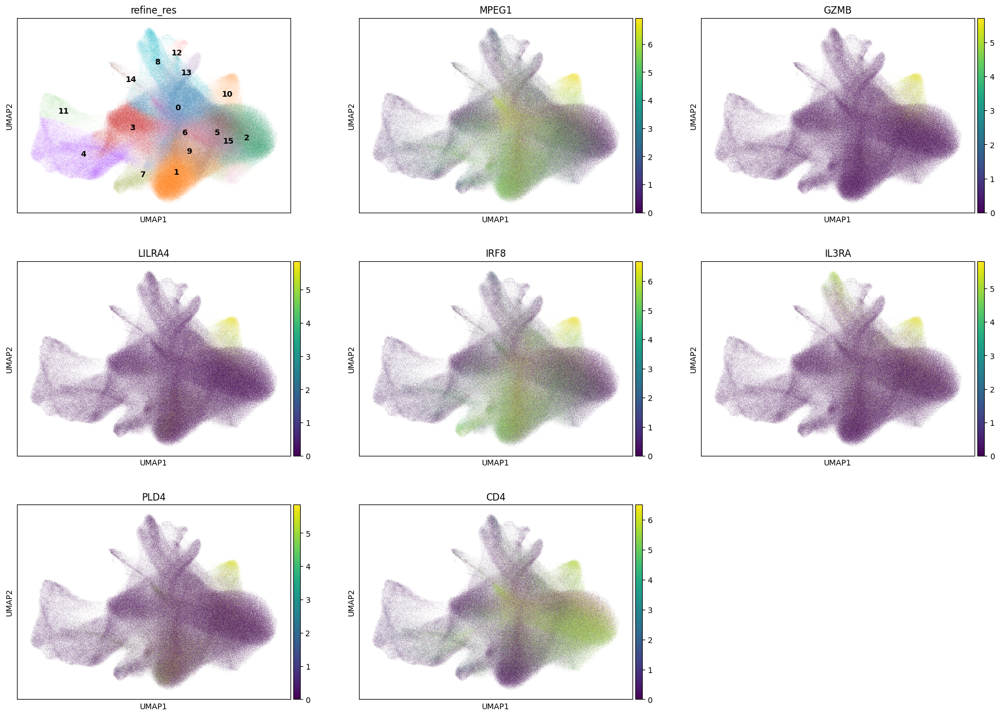

In [162]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [163]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 24560
Percentage of cells in cluster 10: 3.0


In [164]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'pDC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'pDC'

### 5.12. Cluster 11

In [165]:
cluster_id = '11'

In [166]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Epithelial,normal_cell,62.4
1,NA,NA,NA,18.9
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,13.7
3,B,B,normal_cell,3.3
4,T,T,normal_cell,0.7


In [167]:
top_ranked_genes[cluster_id]

0    C15orf48
1     ALDH1A3
2     S100A12
3         EHF
4        MALL
5      GPRC5A
6    SERPINB2
Name: 11, dtype: object

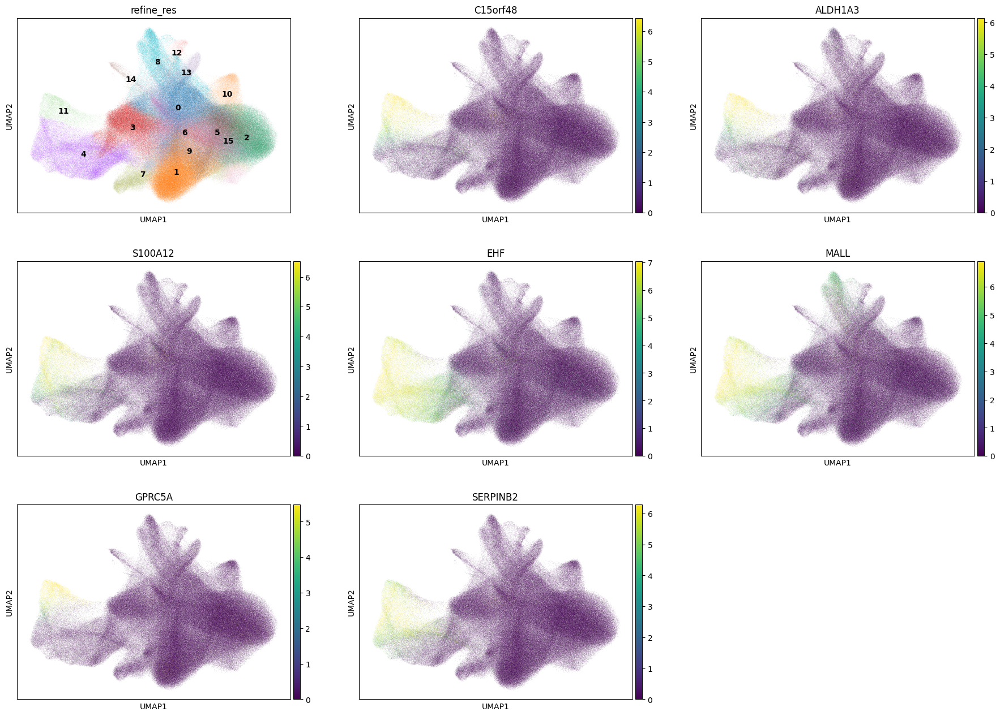

In [168]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [169]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 13085
Percentage of cells in cluster 11: 1.6


In [170]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.13. Cluster 12

In [171]:
cluster_id = '12'

In [172]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage/DC,Macrophage/DC,normal_cell,58.2
1,NA,NA,NA,34.2
2,Endothelial,Endothelial,normal_cell,2.7
3,T,T,normal_cell,1.5
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.2


In [173]:
top_ranked_genes[cluster_id]

0     ACTA2
1     MYH11
2    CAVIN1
3      MYLK
4      CNN1
5      NTN4
6      CAV1
Name: 12, dtype: object

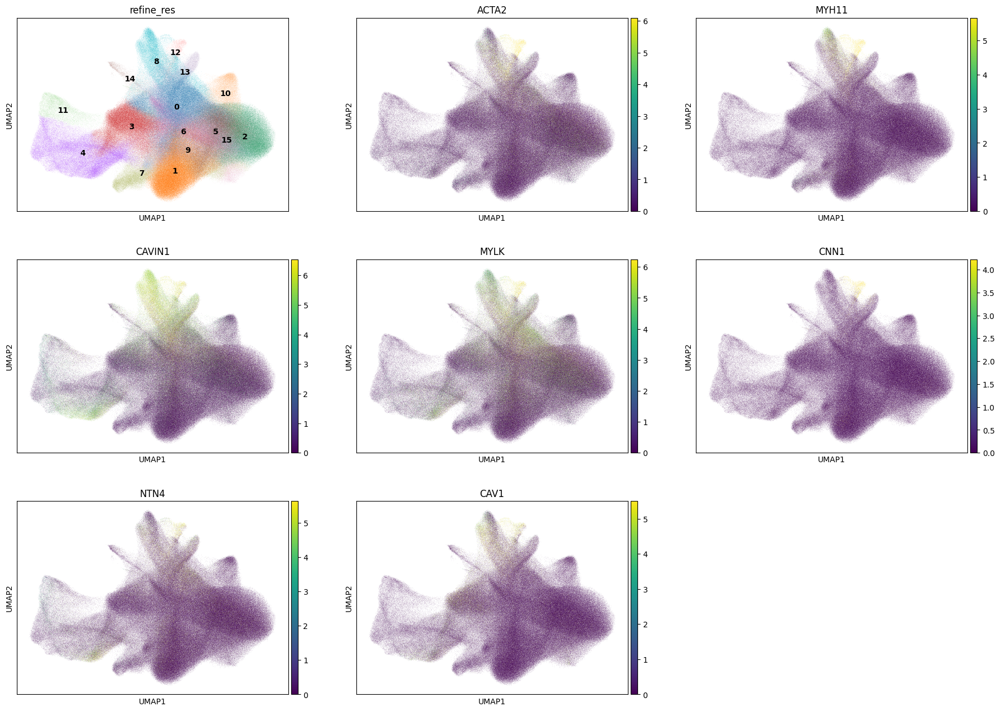

In [174]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [175]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 3891
Percentage of cells in cluster 12: 0.5


In [176]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.14. Cluster 13

In [177]:
cluster_id = '13'

In [178]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage/DC,Macrophage/DC,normal_cell,64.6
1,NA,NA,NA,26.4
2,B,B,normal_cell,2.7
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.9
4,T,T,normal_cell,1.6


In [179]:
top_ranked_genes[cluster_id]

0     FBLN1
1       DPT
2      GPC3
3       OGN
4      CTSK
5    PDGFRA
6     PTGDS
Name: 13, dtype: object

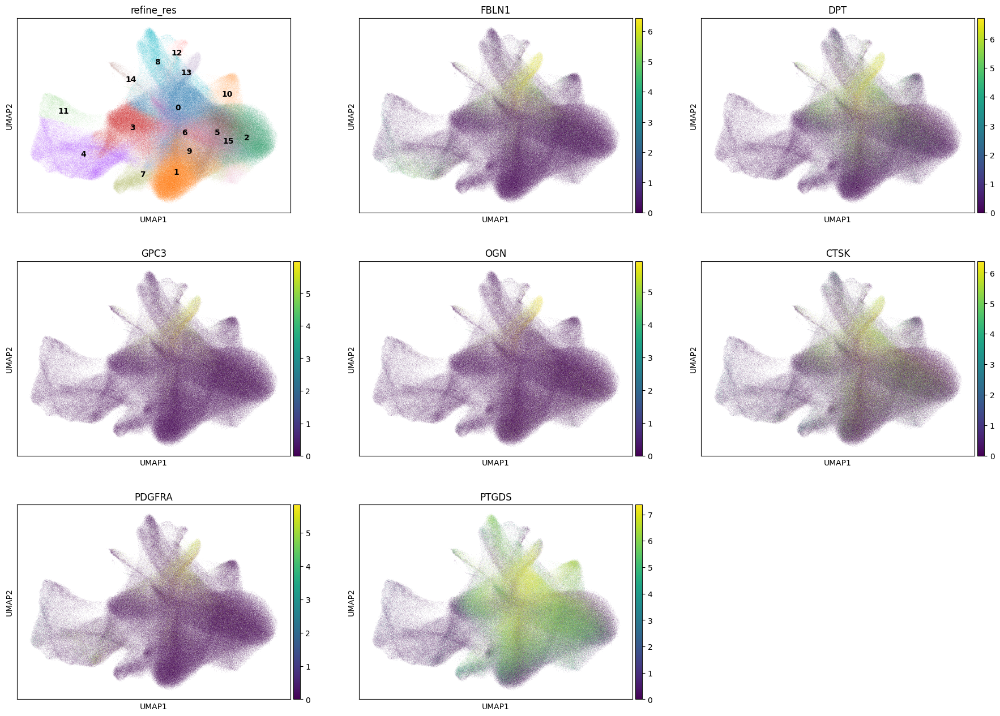

In [180]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [181]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 11937
Percentage of cells in cluster 13: 1.5


In [182]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.15. Cluster 14

In [184]:
cluster_id = '14'

In [185]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,44.7
1,B,B,normal_cell,21.3
2,NA,NA,NA,17.5
3,Plasma,Plasma,normal_cell,6.2
4,Macrophage/DC,Macrophage/DC,normal_cell,3.3


In [186]:
top_ranked_genes[cluster_id]

0       CPA3
1      MS4A2
2        KIT
3      VWA5A
4      GATA2
5     IL1RL1
6    SLC18A2
Name: 14, dtype: object

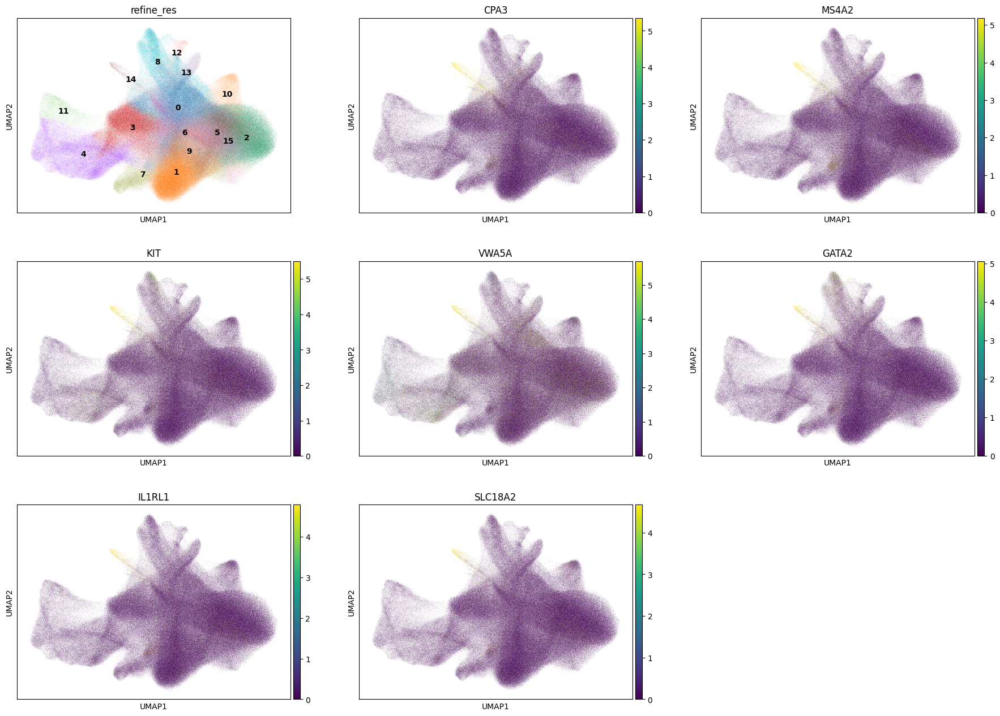

In [187]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [188]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 14: 5314
Percentage of cells in cluster 14: 0.6


In [189]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.16. Cluster 15

In [190]:
cluster_id = '15'

In [191]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,60.5
1,T,T_CD8,normal_cell,29.9
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,2.3
3,B,Proliferating_B,normal_cell,1.8
4,B,B,normal_cell,1.6


In [192]:
top_ranked_genes[cluster_id]

0    CD3E
1     CD2
2    TRAC
3    CD3D
4    CCL5
5    GZMK
6    CD28
Name: 15, dtype: object

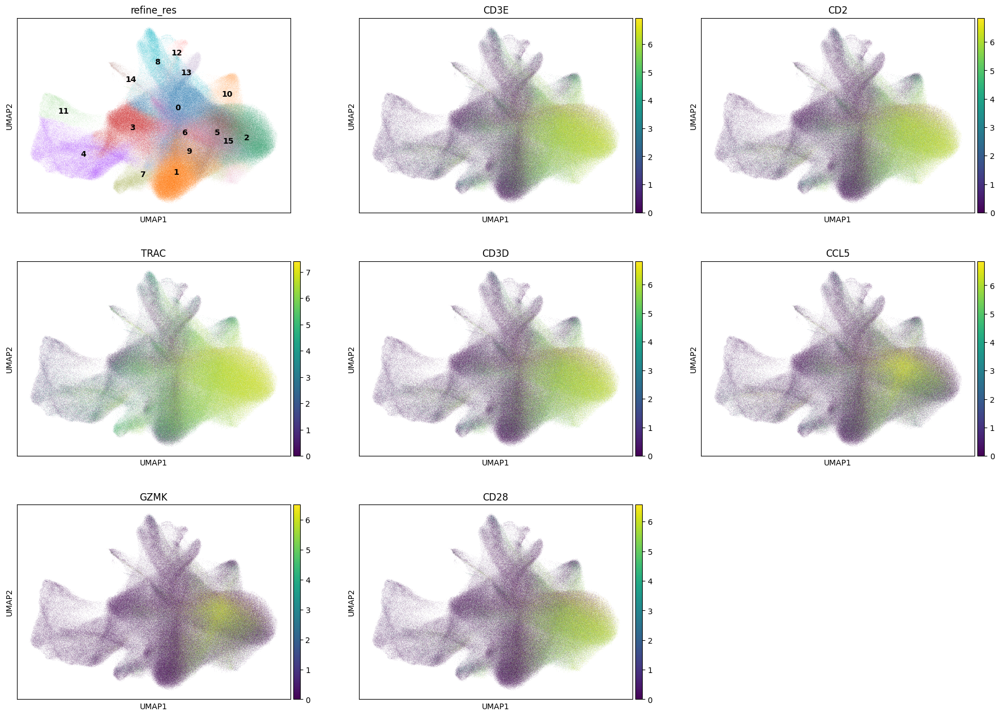

In [193]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [194]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 15: 23630
Percentage of cells in cluster 15: 2.9


In [195]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

## 6. Cancer cells

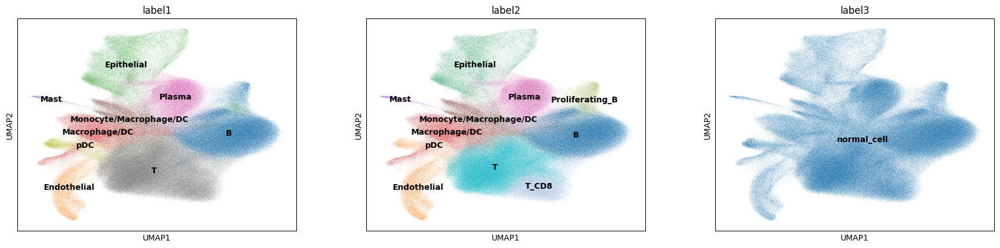

In [196]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

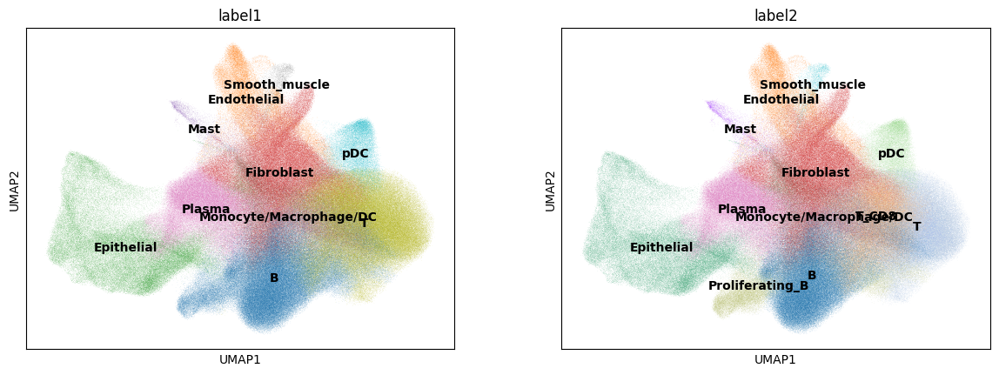

In [197]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [198]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

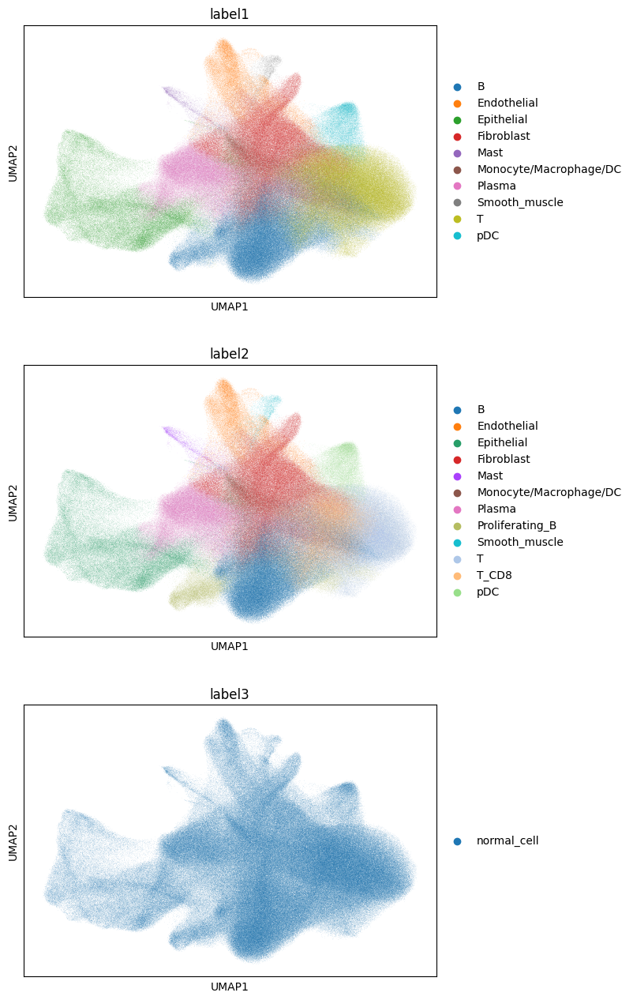

In [199]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [200]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,pca_n10_pcs16_leiden_res0.8,label3
1,aaaaaaab-1,45,0,0,0,0,45,964.853629,21.855626,cell_labels,0,4,5,5,T,T_CD8,5,normal_cell
2,aaaaaaac-1,29,0,0,0,0,29,563.459708,40.008439,cell_labels,0,2,0,0,Fibroblast,Fibroblast,0,normal_cell
4,aaaaaaae-1,11,0,0,0,0,11,147.028755,17.520626,cell_labels,0,2,0,0,Fibroblast,Fibroblast,0,normal_cell
5,aaaaaaaf-1,13,0,0,0,0,13,138.629693,26.822813,cell_labels,0,2,0,0,Fibroblast,Fibroblast,0,normal_cell
6,aaaaaaag-1,17,0,0,0,0,17,192.817194,19.101094,cell_labels,0,2,0,0,Fibroblast,Fibroblast,4,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
864383,aaandahp-1,77,0,0,0,0,77,29.487032,16.617501,cell_labels,0,0,1,1,B,B,1,normal_cell
864384,aaandaia-1,53,0,0,0,0,53,22.713595,14.088751,cell_labels,0,1,2,2,T,T,2,normal_cell
864385,aaandaib-1,116,0,0,0,0,116,44.930470,26.642188,cell_labels,0,1,2,2,T,T,11,normal_cell
864386,aaandaic-1,111,0,0,0,0,111,49.310627,23.255470,cell_labels,0,7,6,6,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,4,normal_cell


In [201]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")